<a href="https://colab.research.google.com/github/Crepopcorn/sit_detection_project/blob/main/custom_head_detetction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **YOLOv8**

In [1]:
!nvidia-smi

Sun Mar 10 06:02:59 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              44W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 720.1/720.1 kB 9.8 MB/s eta 0:00:00


In [3]:
from google.colab import drive
drive.mount('/content/drive')
# check the uploaded dataset
!ls '/content/drive/My Drive/human-head.v1i.yolov8'
!ls '/content/drive/My Drive/human-head.v1i.yolov8/train'
!ls '/content/drive/My Drive/human-head.v1i.yolov8/valid'

Mounted at /content/drive
data.yaml  head_detection.pt  README.dataset.txt  README.roboflow.txt  result.jpg  train  valid
images	labels	labels.cache
images	labels	labels.cache


In [4]:
import timeit
from ultralytics import YOLO

start = timeit.default_timer()

model = YOLO("yolov8m.pt")
yaml_file = "/content/drive/My Drive/human-head.v1i.yolov8/data.yaml"
results = model.train(data=yaml_file, epochs=50, imgsz=600)  # train the model

stop = timeit.default_timer()
print('Head detector Runtime (seconds): ', stop - start)

100%|██████████| 49.7M/49.7M [00:00<00:00, 290MB/s]


Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/My Drive/human-head.v1i.yolov8/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=600, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=Fals

100%|██████████| 755k/755k [00:00<00:00, 27.6MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 92.3MB/s]


AMP: checks passed ✅
WARNING ⚠️ imgsz=[600] must be multiple of max stride 32, updating to [608]


train: Scanning /content/drive/My Drive/human-head.v1i.yolov8/train/labels.cache... 1173 images, 37 backgrounds, 0 corrupt: 100%|██████████| 1173/1173 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/human-head.v1i.yolov8/valid/labels.cache... 293 images, 5 backgrounds, 0 corrupt: 100%|██████████| 293/293 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 608 train, 608 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.78G      1.865      1.593      1.677         21        608: 100%|██████████| 74/74 [00:33<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:02<00:00,  3.38it/s]

                   all        293        761      0.406      0.499       0.32      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      7.02G      1.786      1.355       1.59         24        608: 100%|██████████| 74/74 [00:10<00:00,  7.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.47it/s]


                   all        293        761      0.133      0.314     0.0903     0.0305

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.71G      1.772      1.359      1.609         12        608: 100%|██████████| 74/74 [00:09<00:00,  7.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.36it/s]


                   all        293        761      0.218      0.184      0.103     0.0371

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.71G      1.719       1.31       1.56         23        608: 100%|██████████| 74/74 [00:09<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.39it/s]

                   all        293        761      0.697      0.549      0.641       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.72G      1.684      1.237      1.538         18        608: 100%|██████████| 74/74 [00:09<00:00,  7.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.41it/s]

                   all        293        761      0.806      0.701      0.795      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.72G      1.682      1.211      1.523         19        608: 100%|██████████| 74/74 [00:09<00:00,  7.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.94it/s]

                   all        293        761      0.807      0.603      0.712      0.325



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.72G      1.638      1.177      1.502         10        608: 100%|██████████| 74/74 [00:09<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.84it/s]

                   all        293        761      0.905      0.683      0.832      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.71G       1.62      1.149      1.489         12        608: 100%|██████████| 74/74 [00:10<00:00,  7.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.53it/s]

                   all        293        761      0.845      0.687      0.827      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       6.7G      1.577      1.089      1.465         21        608: 100%|██████████| 74/74 [00:09<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.89it/s]


                   all        293        761      0.911      0.727      0.856      0.449

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       6.7G      1.535      1.013       1.42         23        608: 100%|██████████| 74/74 [00:10<00:00,  7.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.15it/s]

                   all        293        761      0.927      0.678      0.833      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      6.72G      1.519     0.9882      1.423         14        608: 100%|██████████| 74/74 [00:09<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.52it/s]

                   all        293        761      0.787      0.695      0.814      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.72G      1.512     0.9905      1.419         27        608: 100%|██████████| 74/74 [00:09<00:00,  7.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.10it/s]

                   all        293        761      0.925      0.686      0.851      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.71G      1.491     0.9795      1.401         22        608: 100%|██████████| 74/74 [00:09<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.98it/s]


                   all        293        761      0.876       0.81      0.895      0.489

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      6.71G       1.47      0.935      1.397         15        608: 100%|██████████| 74/74 [00:09<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.01it/s]

                   all        293        761       0.84      0.744      0.876      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      6.73G      1.451     0.9318      1.382         11        608: 100%|██████████| 74/74 [00:09<00:00,  7.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.87it/s]

                   all        293        761      0.916        0.7      0.872      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       6.7G      1.422     0.9221      1.356         24        608: 100%|██████████| 74/74 [00:09<00:00,  7.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.22it/s]

                   all        293        761      0.861       0.74      0.858      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      6.71G      1.431     0.9003       1.35         13        608: 100%|██████████| 74/74 [00:09<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.87it/s]

                   all        293        761      0.936      0.833      0.924      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      6.69G      1.407     0.8819      1.351         21        608: 100%|██████████| 74/74 [00:10<00:00,  7.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.00it/s]

                   all        293        761      0.811      0.747      0.871      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      6.72G       1.39     0.8615      1.326         13        608: 100%|██████████| 74/74 [00:09<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.90it/s]

                   all        293        761      0.898      0.802      0.908      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.71G      1.382     0.8522      1.331         17        608: 100%|██████████| 74/74 [00:10<00:00,  7.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.59it/s]

                   all        293        761      0.798      0.803      0.879      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.72G      1.357     0.8489      1.317         21        608: 100%|██████████| 74/74 [00:09<00:00,  7.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.04it/s]

                   all        293        761      0.887       0.82      0.907       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      6.71G      1.323     0.8176      1.302         32        608: 100%|██████████| 74/74 [00:10<00:00,  7.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.23it/s]


                   all        293        761      0.936      0.813      0.915      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       6.7G      1.328     0.8026      1.301         20        608: 100%|██████████| 74/74 [00:09<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.01it/s]

                   all        293        761      0.785      0.842      0.893      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       6.7G      1.309     0.7956      1.277         32        608: 100%|██████████| 74/74 [00:09<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.32it/s]


                   all        293        761      0.823      0.827        0.9      0.517

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       6.7G      1.298     0.7668      1.283         21        608: 100%|██████████| 74/74 [00:09<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.16it/s]

                   all        293        761      0.792      0.819      0.888      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      6.71G      1.273     0.7601      1.254         20        608: 100%|██████████| 74/74 [00:09<00:00,  7.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.31it/s]

                   all        293        761      0.852      0.796      0.902      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      6.71G      1.255     0.7361      1.259         23        608: 100%|██████████| 74/74 [00:09<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.08it/s]

                   all        293        761      0.822      0.826      0.904      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      6.71G      1.239     0.7411      1.231         38        608: 100%|██████████| 74/74 [00:09<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.17it/s]


                   all        293        761      0.897      0.799      0.911      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      6.72G      1.239     0.7234      1.242         26        608: 100%|██████████| 74/74 [00:09<00:00,  7.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.11it/s]

                   all        293        761      0.888       0.83      0.911      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       6.7G      1.206     0.7155      1.226         12        608: 100%|██████████| 74/74 [00:09<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.92it/s]

                   all        293        761      0.845      0.822      0.912      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      6.72G      1.199     0.7076      1.223         20        608: 100%|██████████| 74/74 [00:09<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.21it/s]

                   all        293        761      0.822      0.835      0.907      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       6.7G       1.19      0.686      1.212         28        608: 100%|██████████| 74/74 [00:09<00:00,  7.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.13it/s]

                   all        293        761      0.915      0.817       0.92       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.72G      1.163     0.6844      1.197         20        608: 100%|██████████| 74/74 [00:10<00:00,  7.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.07it/s]

                   all        293        761      0.875      0.812      0.912      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.71G      1.177     0.6818      1.209         10        608: 100%|██████████| 74/74 [00:10<00:00,  7.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.14it/s]

                   all        293        761      0.886      0.816      0.917      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      6.72G      1.134     0.6567      1.182         20        608: 100%|██████████| 74/74 [00:09<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.18it/s]

                   all        293        761      0.875      0.816      0.916      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50       6.7G      1.121     0.6364       1.17         23        608: 100%|██████████| 74/74 [00:09<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.15it/s]

                   all        293        761      0.921      0.847       0.93       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.73G      1.102     0.6281      1.168         22        608: 100%|██████████| 74/74 [00:09<00:00,  7.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.15it/s]

                   all        293        761      0.887      0.866      0.935      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.71G      1.105     0.6172      1.152         10        608: 100%|██████████| 74/74 [00:09<00:00,  7.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.90it/s]

                   all        293        761      0.907      0.846      0.936      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.71G      1.058     0.5984       1.14         15        608: 100%|██████████| 74/74 [00:09<00:00,  7.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.90it/s]

                   all        293        761      0.909      0.855      0.927      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.71G      1.058     0.6002      1.135         24        608: 100%|██████████| 74/74 [00:09<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.33it/s]

                   all        293        761      0.895       0.85      0.927      0.571


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.73G      1.019     0.5464      1.138         13        608: 100%|██████████| 74/74 [00:12<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.88it/s]

                   all        293        761      0.893      0.827      0.921      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50       6.7G      1.002     0.5207      1.126         11        608: 100%|██████████| 74/74 [00:09<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.01it/s]

                   all        293        761      0.912       0.85      0.929      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.71G     0.9846     0.5177      1.122         20        608: 100%|██████████| 74/74 [00:09<00:00,  7.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.98it/s]

                   all        293        761      0.906      0.834      0.924      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.71G     0.9778     0.5023      1.112         12        608: 100%|██████████| 74/74 [00:09<00:00,  7.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.24it/s]


                   all        293        761      0.859      0.823      0.909      0.566

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.71G     0.9557     0.4985      1.101         23        608: 100%|██████████| 74/74 [00:09<00:00,  7.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.06it/s]

                   all        293        761      0.885      0.812      0.917      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50       6.7G     0.9266     0.4827      1.086         24        608: 100%|██████████| 74/74 [00:09<00:00,  7.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.15it/s]

                   all        293        761        0.9      0.846      0.929      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.73G     0.9232     0.4725      1.091         14        608: 100%|██████████| 74/74 [00:09<00:00,  7.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  6.90it/s]

                   all        293        761      0.893      0.856      0.928       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.71G     0.8904     0.4576      1.068         33        608: 100%|██████████| 74/74 [00:09<00:00,  7.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.15it/s]

                   all        293        761      0.886      0.878       0.93      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.71G     0.8628     0.4397      1.054          9        608: 100%|██████████| 74/74 [00:09<00:00,  7.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.20it/s]


                   all        293        761      0.885      0.834      0.922       0.58

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       6.7G     0.8538     0.4435       1.05         17        608: 100%|██████████| 74/74 [00:09<00:00,  7.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:01<00:00,  7.08it/s]

                   all        293        761      0.892      0.848      0.927      0.583



50 epochs completed in 0.186 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:03<00:00,  2.63it/s]


                   all        293        761      0.902      0.845      0.929      0.593
Speed: 0.4ms preprocess, 6.4ms inference, 0.0ms loss, 2.9ms postprocess per image
Results saved to runs/detect/train
Head detector Runtime (seconds):  699.424590238


In [5]:
results = model.val()

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/My Drive/human-head.v1i.yolov8/valid/labels.cache... 293 images, 5 backgrounds, 0 corrupt: 100%|██████████| 293/293 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.59it/s]


                   all        293        761      0.901      0.845      0.929      0.593
Speed: 0.1ms preprocess, 3.3ms inference, 0.0ms loss, 8.0ms postprocess per image
Results saved to runs/detect/train2


In [6]:
model.info(detailed=True)

layer                                     name  gradient   parameters                shape         mu      sigma
    0                      model.0.conv.weight     False         1296        [48, 3, 3, 3]     -0.125       10.1 torch.float32
    1                        model.0.conv.bias     False           48                 [48]      0.919       1.88 torch.float32
    2                      model.1.conv.weight     False        41472       [96, 48, 3, 3]   -0.00238     0.0678 torch.float32
    3                        model.1.conv.bias     False           96                 [96]       1.21       2.17 torch.float32
    4                  model.2.cv1.conv.weight     False         9216       [96, 96, 1, 1]   -0.00948     0.0665 torch.float32
    5                    model.2.cv1.conv.bias     False           96                 [96]       1.15       0.85 torch.float32
    6                  model.2.cv2.conv.weight     False        18432      [96, 192, 1, 1]   -0.00508     0.0406 torch.float3

(218, 25840339, 0, 78.6886656)

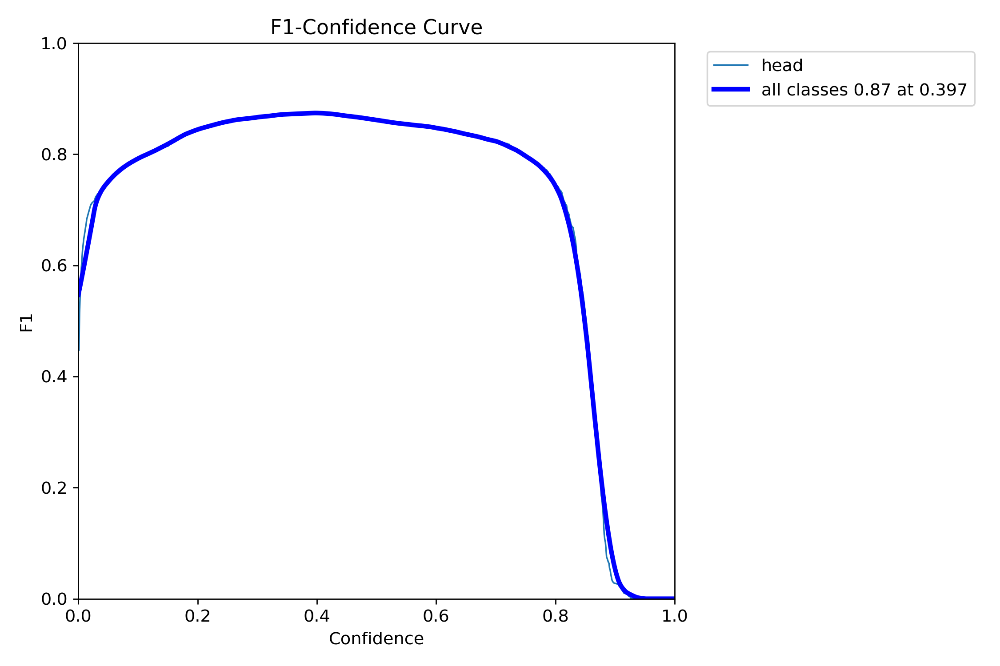

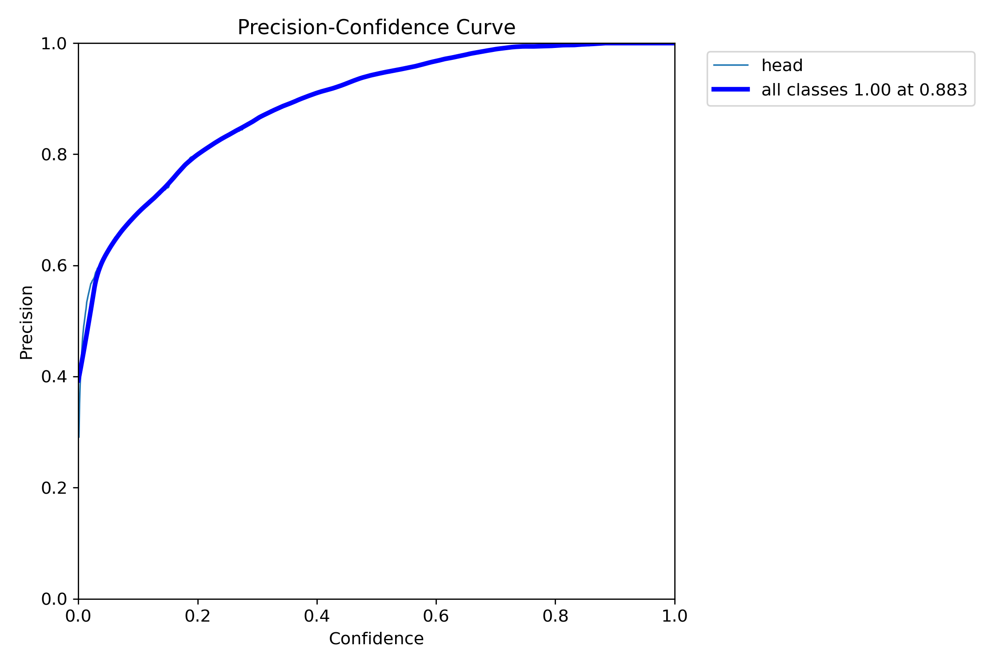

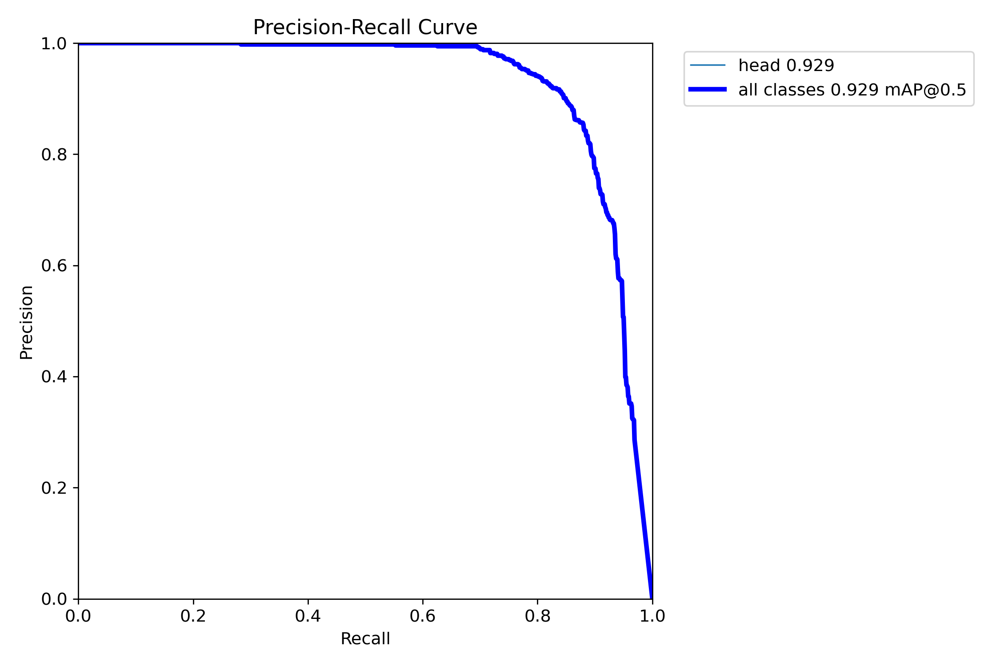

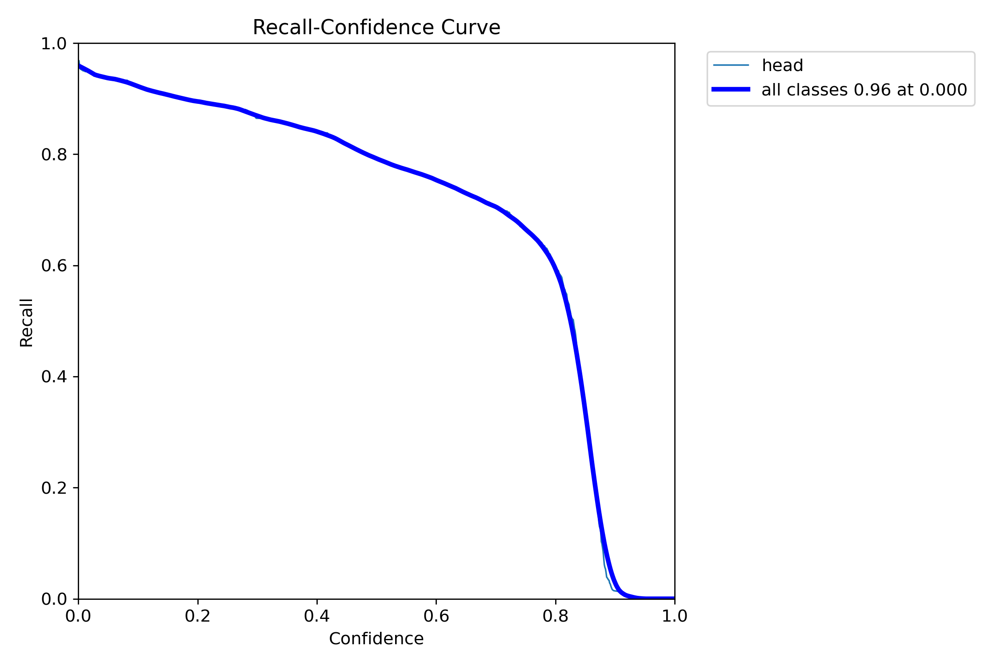

In [7]:
# dislaying train data metrics

from IPython.display import Image
from IPython.display import display

x1 = Image(filename='runs/detect/train/F1_curve.png')
x2 = Image(filename='runs/detect/train/P_curve.png')
x3 = Image(filename='runs/detect/train/PR_curve.png')
x4 = Image(filename='runs/detect/train/R_curve.png')

display(x1, x2, x3, x4)

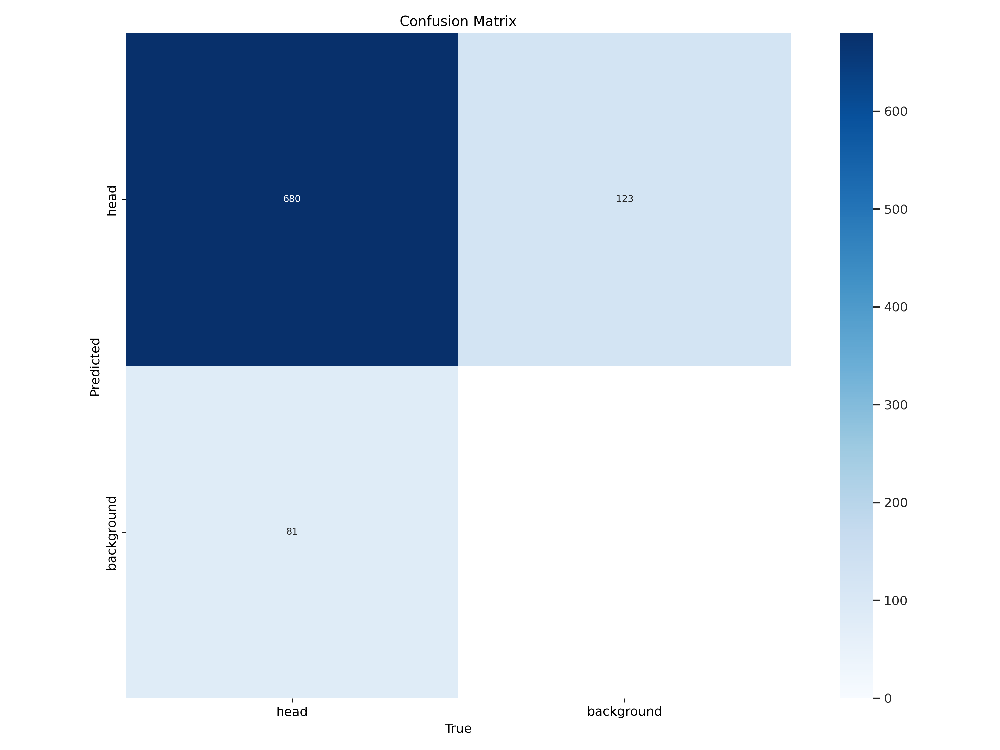

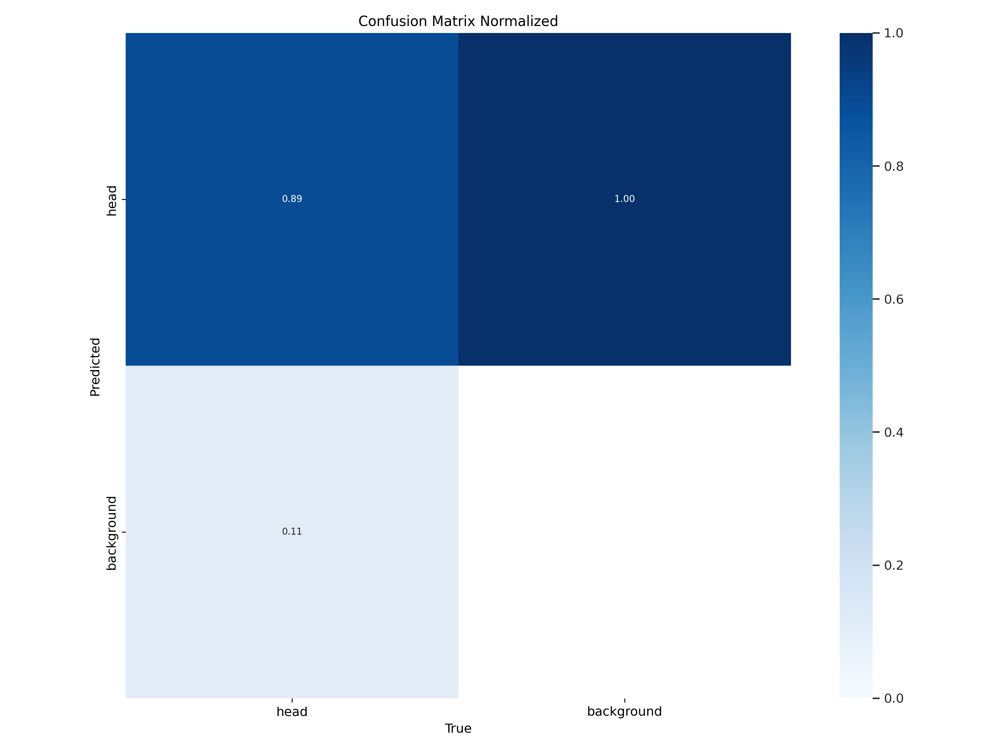

In [8]:
y1 = Image(filename='runs/detect/train/confusion_matrix.png')
y2 = Image(filename='runs/detect/train/confusion_matrix_normalized.png')
display(y1, y2)

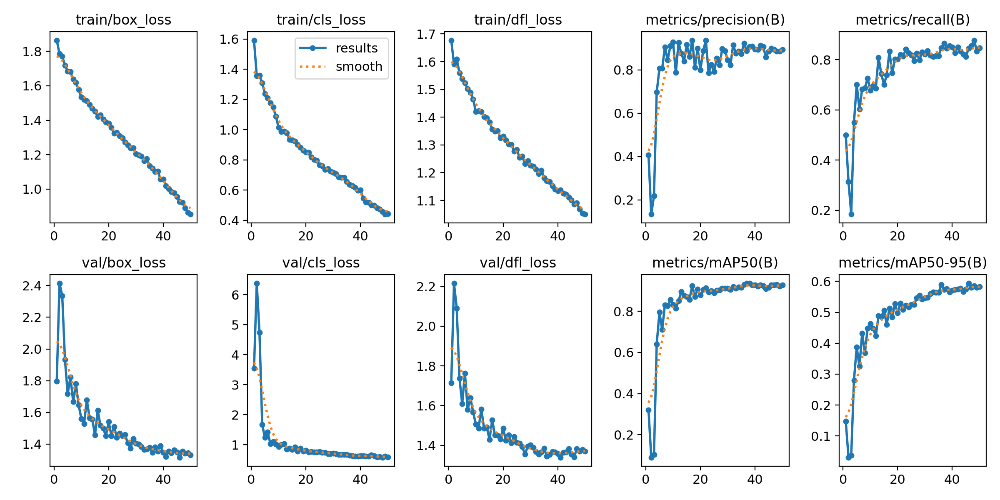

In [9]:
Image(filename=f'/content/runs/detect/train/results.png', width = 600)

# **Model Weight and Analysis**

In [10]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [11]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [12]:
# checking the latest trained files
!ls 'runs/detect/train/weights'

best.pt  last.pt


In [13]:
# loading the trianed model
model = YOLO("runs/detect/train/weights/best.pt")

In [14]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/sit_video.mp4'

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 151.8ms
video 1/1 (2/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 (no detections), 10.1ms
video 1/1 (3/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 9.6ms
video 1/1 (4/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 10.8ms
video 1/1 (5/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 9.8ms
video 1/1 (6/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 10.0ms
video 1/1 (7/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 10.2ms
video 1/1 (8/302) /content/drive/My Drive/Camera Roll/sit_video.mp4: 352x608 1 head, 9.7ms
video 1/1 (9/302) /content/drive/My Drive/Camera Roll/sit_video.mp

In [15]:
!ls 'runs/detect/predict'

sit_video.avi


In [16]:
from moviepy.editor import *

path="runs/detect/predict/sit_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



t: 100%|██████████| 303/303 [00:02<00:00, 147.05it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file runs/detect/predict/sit_video.avi, 2764800 bytes wanted but 0 bytes read,at frame 302/303, at time 10.07/10.07 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

                                                               

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [17]:
!yolo task=detect mode=predict model="runs/detect/train/weights/best.pt" source='/content/drive/My Drive/Camera Roll/side_video.mp4'

Ultralytics YOLOv8.1.25 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 159.1ms
video 1/1 (2/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 10.0ms
video 1/1 (3/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 9.6ms
video 1/1 (4/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 9.5ms
video 1/1 (5/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 10.1ms
video 1/1 (6/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 9.5ms
video 1/1 (7/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 9.5ms
video 1/1 (8/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608 1 head, 10.8ms
video 1/1 (9/308) /content/drive/My Drive/Camera Roll/side_video.mp4: 352x608

In [18]:
!ls 'runs/detect/predict2'

side_video.avi


In [19]:
from moviepy.editor import *

path="runs/detect/predict2/side_video.avi"

clip=VideoFileClip(path)
clip.ipython_display(width=600)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [20]:
import shutil

shutil.copy("runs/detect/train/weights/best.pt", "/content/drive/My Drive/human-head.v1i.yolov8/")

'/content/drive/My Drive/human-head.v1i.yolov8/best.pt'